In [1]:
import torch
from torchvision import transforms
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torch.utils.data import RandomSampler
import numpy as np
import matplotlib.pyplot as plt
import cv2
import pandas as pd
from torch_snippets import *
from torchsummary import summary
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# models

In [20]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [21]:
class Discriminator(nn.Module):
    def __init__(self,relu=0.2):
        super().__init__()
        self.relu = relu
        self.model = nn.Sequential(
            nn.Conv2d(3,64,4,2,1,bias=False), # 32
            nn.BatchNorm2d(64),
            nn.LeakyReLU(self.relu),
            nn.Conv2d(64,128,4,2,1,bias=False), # 16
            nn.BatchNorm2d(128),
            nn.LeakyReLU(self.relu),
            nn.Conv2d(128,256,4,2,1,bias=False), # 8
            nn.BatchNorm2d(256),
            nn.LeakyReLU(self.relu),
            nn.Conv2d(256,512,4,2,1,bias=False), # 4
            nn.BatchNorm2d(512),
            nn.LeakyReLU(self.relu),
            nn.AvgPool2d(kernel_size=4,stride=1,padding=0), # 1
            nn.Flatten(),
            nn.Linear(512,1),
        )
        self.apply(weights_init)
    def forward(self,x):
        x = self.model(x)
        return x

In [22]:
discriminator = Discriminator().to(device)
summary(discriminator, torch.zeros((1,3,64,64)))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 1]                   --
|    └─Conv2d: 2-1                       [-1, 64, 32, 32]          3,072
|    └─BatchNorm2d: 2-2                  [-1, 64, 32, 32]          128
|    └─LeakyReLU: 2-3                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-4                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-5                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-6                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-7                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-8                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-9                    [-1, 256, 8, 8]           --
|    └─Conv2d: 2-10                      [-1, 512, 4, 4]           2,097,152
|    └─BatchNorm2d: 2-11                 [-1, 512, 4, 4]           1,024
|    └─LeakyReLU: 2-12                   [-1, 512, 4, 4]   

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 1]                   --
|    └─Conv2d: 2-1                       [-1, 64, 32, 32]          3,072
|    └─BatchNorm2d: 2-2                  [-1, 64, 32, 32]          128
|    └─LeakyReLU: 2-3                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-4                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-5                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-6                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-7                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-8                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-9                    [-1, 256, 8, 8]           --
|    └─Conv2d: 2-10                      [-1, 512, 4, 4]           2,097,152
|    └─BatchNorm2d: 2-11                 [-1, 512, 4, 4]           1,024
|    └─LeakyReLU: 2-12                   [-1, 512, 4, 4]   

In [23]:
class Generator(nn.Module):
    def __init__(self,noise_dim=100):
        super().__init__()
        self.noise_dim = noise_dim
        self.model = nn.Sequential(
            nn.ConvTranspose2d(noise_dim,512,4,1,0,bias=False), # 4
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(512,256,4,2,1,bias=False), # 8
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256,128,4,2,1,bias=False), # 16
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128,64,4,2,1,bias=False), # 32
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64,3,4,2,1,bias=False), # 64
            nn.Tanh()
        )
        self.apply(weights_init)
    def forward(self, x):
        x = x.view(-1,self.noise_dim,1,1)
        return self.model(x)

In [24]:
generator = Generator().to(device)
summary(generator, torch.zeros((1,100)))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 3, 64, 64]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           819,200
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32]          128
|    └─ReLU: 2-12                        [-1, 64, 32, 32]

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 3, 64, 64]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           819,200
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32]          128
|    └─ReLU: 2-12                        [-1, 64, 32, 32]

# data pipeline

In [25]:
import os
os.listdir("../../Datasets/male_female_face_images")

['cropped_faces', 'females', 'males']

In [26]:
img_transform = transforms.Compose([
    transforms.Resize([64,64]),
    transforms.RandomHorizontalFlip(0.5),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [27]:
from PIL import Image
class face_dataset(Dataset):
    def __init__(self, folder_path = "../../Datasets/male_female_face_images",transform=img_transform):
        super().__init__()
        male_paths = [folder_path+"/males/"+name for name in os.listdir(folder_path+"/males")]
        female_paths = [folder_path+"/females/"+name for name in os.listdir(folder_path+"/females")]
        male_paths.extend(female_paths)
        self.image_paths = male_paths
        self.transform = transform
    
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image


In [30]:
class face_dataset2(Dataset):
    def __init__(self, folder_path = "../../Datasets/male_female_face_images/cropped_faces",transform=img_transform):
        super().__init__()
        paths = [folder_path+"/"+name for name in os.listdir(folder_path)]
        self.image_paths = paths
        self.transform = transform
    
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image

28636

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


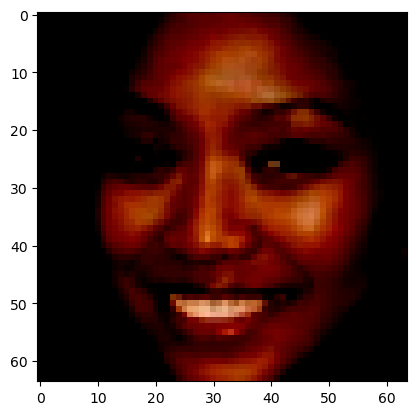

In [31]:
ds = face_dataset2()
print(len(ds))
img1 = ds[1]
plt.imshow(img1.numpy().transpose(1,2,0))


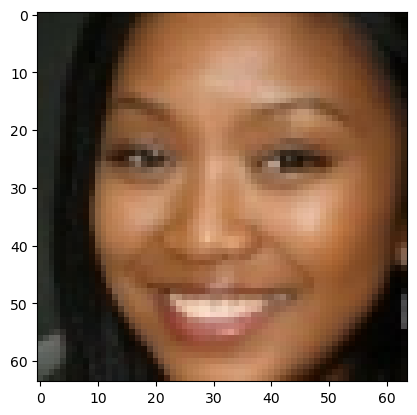

In [32]:
plt.imshow(np.transpose(torchvision.utils.make_grid(img1[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [33]:
batch_size = 128
dataloader = DataLoader(ds,batch_size,shuffle=True)
len(dataloader)

224

In [9]:
real_batch = next(iter(dataloader))
real_batch.shape

torch.Size([128, 3, 64, 64])

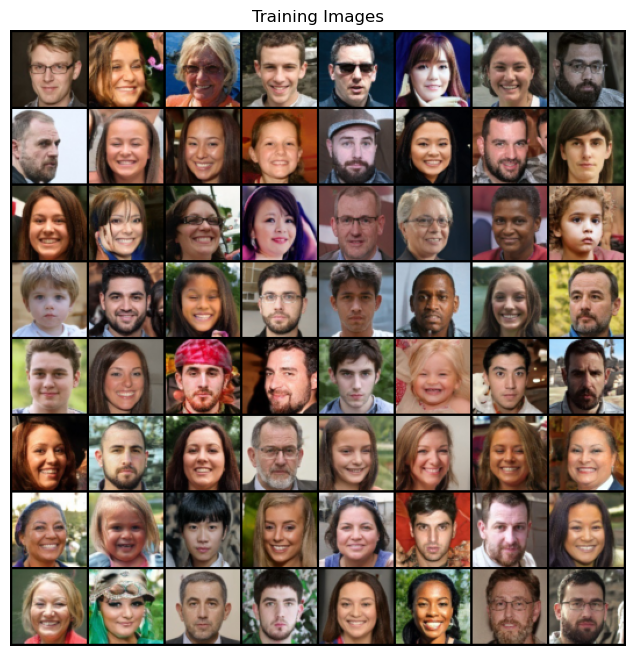

In [10]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(torchvision.utils.make_grid(real_batch.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# training routine

In [34]:
def train_discriminator(discriminator,fake_data,real_data,loss_fn,optimizer):
    optimizer.zero_grad()
    pred_fake = discriminator(fake_data)
    loss_fake = loss_fn(pred_fake,torch.full(size=(len(fake_data),1),fill_value=0.1).to(device))
    loss_fake.backward()
    pred_real = discriminator(real_data)
    loss_real = loss_fn(pred_real,torch.full(size=(len(real_data),1),fill_value=0.9).to(device))
    loss_real.backward()
    optimizer.step()
    return loss_real, loss_fake

In [35]:
def train_generator(discriminator, fake_data, loss_fn, optimizer):
    optimizer.zero_grad()
    pred = discriminator(fake_data)
    loss = loss_fn(pred,torch.full(size=(len(fake_data),1),fill_value=0.9).to(device))
    loss.backward()
    optimizer.step()
    return loss

In [36]:
def noise_generator(batch_size=128,noise_dim=1024):
    return torch.randn((batch_size,noise_dim)).to(device)

In [16]:
model_name = "face_resGAN"
if not os.path.exists(model_name):
    os.makedirs(model_name)

In [37]:
loss_fn = torch.nn.BCEWithLogitsLoss()
d_optimizer = torch.optim.AdamW(discriminator.parameters(),lr=2e-4)
g_optimizer = torch.optim.AdamW(generator.parameters(),lr=2e-4)

**label_smooth, original_image, 100**

EPOCH: 5.000  g_loss: 1.951  d_loss: 0.714  (112.65s - 1239.14s remaining)
EPOCH: 10.000  g_loss: 2.060  d_loss: 0.705  (225.47s - 1127.33s remaining)


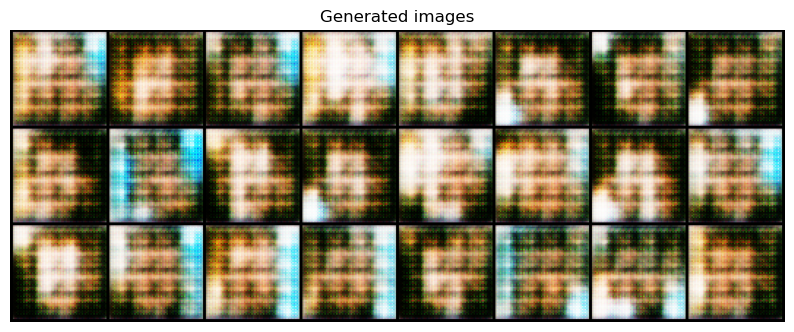

EPOCH: 15.000  g_loss: 2.120  d_loss: 0.677  (338.95s - 1016.86s remaining)
EPOCH: 20.000  g_loss: 2.048  d_loss: 0.720  (454.22s - 908.44s remaining))


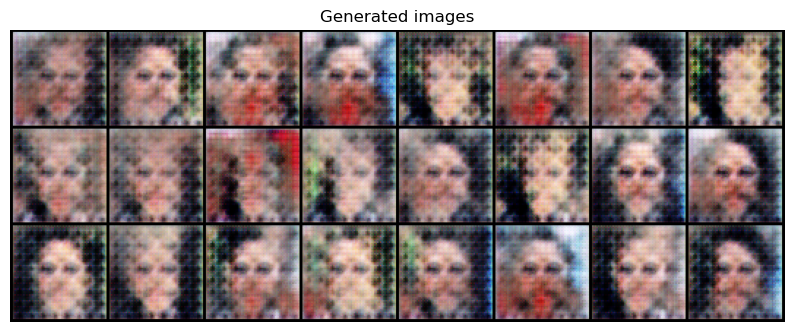

EPOCH: 25.000  g_loss: 2.123  d_loss: 0.730  (569.11s - 796.75s remaining)
EPOCH: 30.000  g_loss: 2.143  d_loss: 0.723  (678.58s - 678.58s remaining)


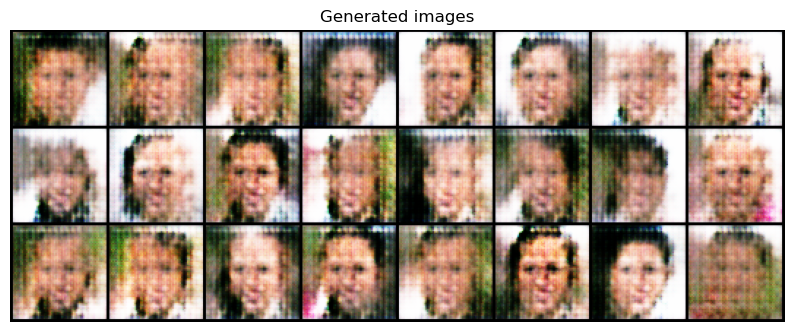

EPOCH: 35.000  g_loss: 2.052  d_loss: 0.716  (811.47s - 579.62s remaining)
EPOCH: 40.000  g_loss: 2.182  d_loss: 0.719  (925.05s - 462.52s remaining)


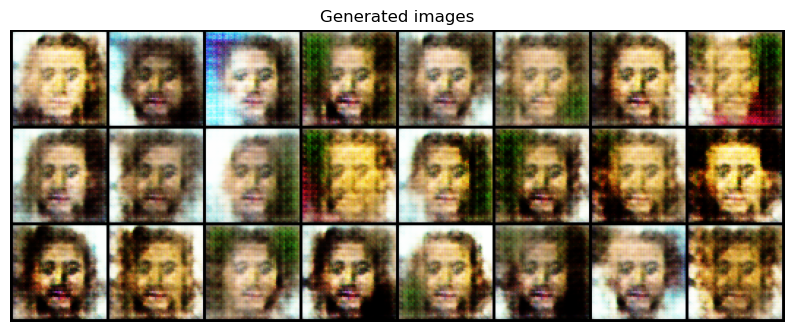

EPOCH: 45.000  g_loss: 2.087  d_loss: 0.726  (1037.47s - 345.82s remaining)
EPOCH: 50.000  g_loss: 2.070  d_loss: 0.723  (1151.96s - 230.39s remaining)


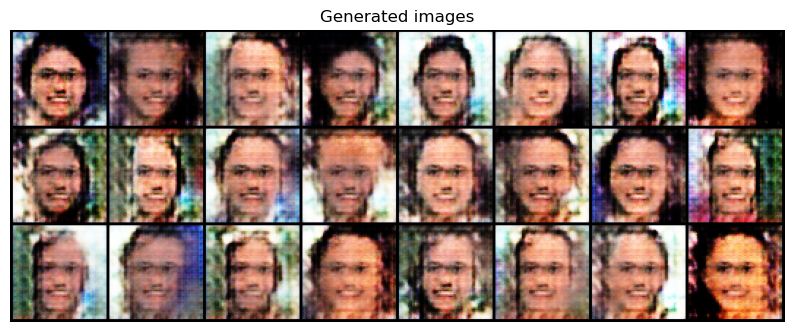

EPOCH: 55.000  g_loss: 2.063  d_loss: 0.717  (1267.45s - 115.22s remaining)
EPOCH: 60.000  g_loss: 2.101  d_loss: 0.714  (1394.03s - 0.00s remaining)))


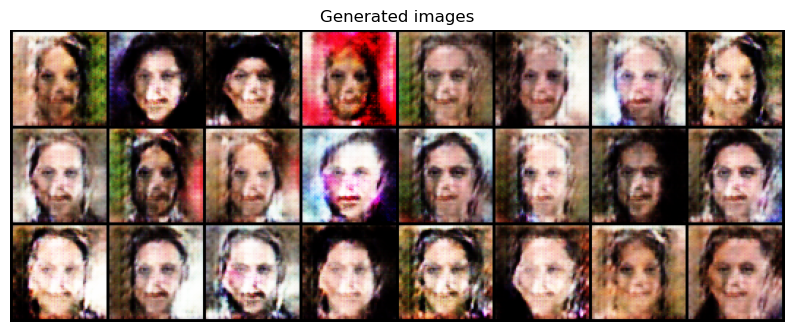

100%|██████████| 161/161 [00:00<00:00, 483.71it/s]


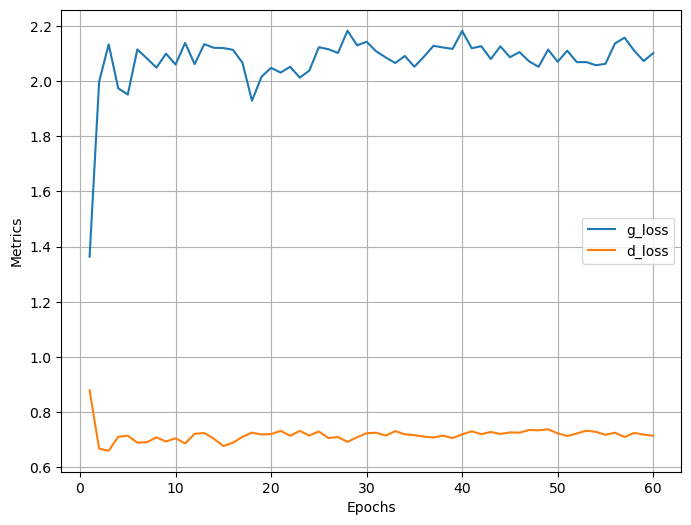

In [19]:
N = len(dataloader)
num_epochs = 60
log = Report(num_epochs)
repeat_generator=1
noise_dim = 100
batch_size = 128

for epoch in range(num_epochs):
    for idx, imgs in enumerate(dataloader):
        real_data = imgs.to(device)
        fake_data = generator(noise_generator(batch_size,noise_dim).to(device))
        fake_data = fake_data.detach()
        real_loss, fake_loss = train_discriminator(discriminator,fake_data,real_data,loss_fn,d_optimizer)
        real_loss, fake_loss = real_loss.item(), fake_loss.item()
        d_total = real_loss + fake_loss
        g_total = 0
        g_batch = 0
        #while g_avg >= 3:
        for i in range(repeat_generator):
            fake_data = generator(noise_generator(batch_size,noise_dim).to(device))
            g_loss = train_generator(discriminator,fake_data,loss_fn,g_optimizer)
            g_total += g_loss.item()

        log.record(epoch+(idx+1)/N,g_loss = g_total, d_loss = d_total, end='\r')
    if (epoch+1)%5 == 0:
        log.report_avgs(epoch+1)
    if (epoch+1)%10 == 0:
        torch.save(generator.state_dict(),model_name+r'/generator.pth')
        torch.save(discriminator.state_dict(),model_name+r"/discriminator.pth")
        generator.eval()
        noise = torch.randn(24, 100, device=device)
        sample_images = generator(noise).detach().cpu()
        grid = torchvision.utils.make_grid(sample_images, nrow=8, normalize=True)
        show(grid.cpu().detach().permute(1,2,0), sz=10, title='Generated images')
log.plot_epochs(['g_loss','d_loss'])

**label_smooth, cropped_image, 100**

EPOCH: 5.000  g_loss: 2.102  d_loss: 0.672  (111.95s - 1231.42s remaining)
EPOCH: 10.000  g_loss: 2.087  d_loss: 0.701  (205.90s - 1029.51s remaining)


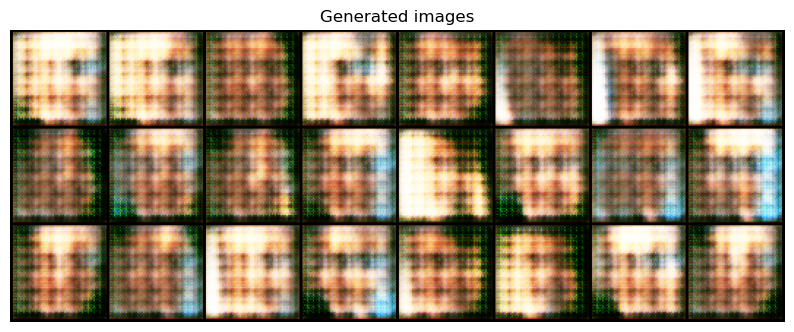

EPOCH: 15.000  g_loss: 2.076  d_loss: 0.698  (300.00s - 900.00s remaining))
EPOCH: 20.000  g_loss: 2.055  d_loss: 0.711  (393.33s - 786.66s remaining)


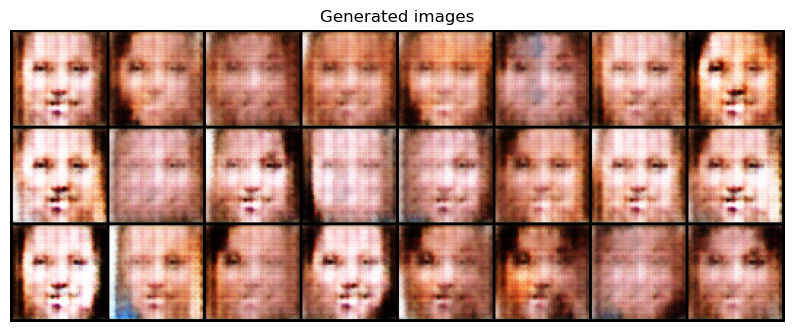

EPOCH: 25.000  g_loss: 2.109  d_loss: 0.714  (486.92s - 681.69s remaining)
EPOCH: 30.000  g_loss: 2.115  d_loss: 0.721  (580.17s - 580.17s remaining)


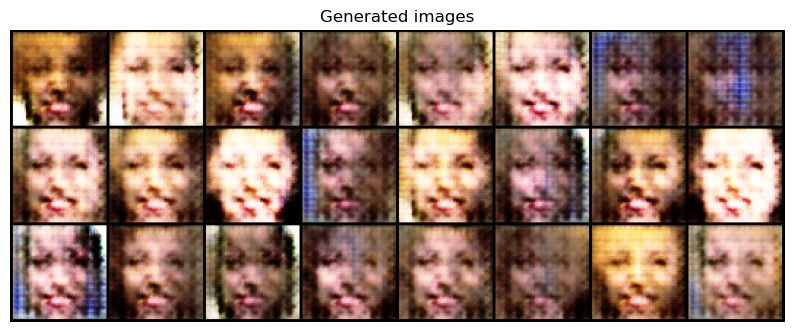

EPOCH: 35.000  g_loss: 2.173  d_loss: 0.717  (674.24s - 481.60s remaining)
EPOCH: 40.000  g_loss: 2.199  d_loss: 0.709  (768.34s - 384.17s remaining)


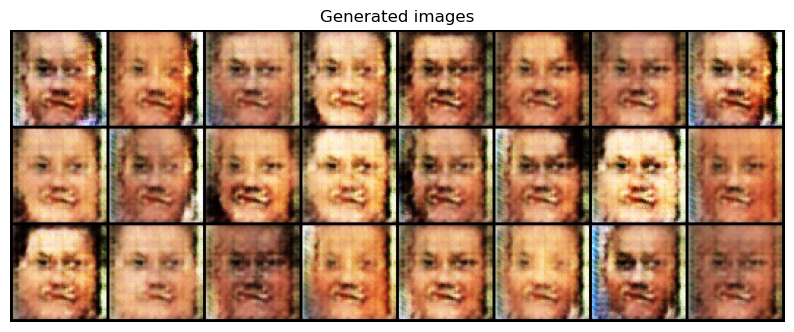

EPOCH: 45.000  g_loss: 2.190  d_loss: 0.713  (862.60s - 287.53s remaining)
EPOCH: 50.000  g_loss: 2.116  d_loss: 0.708  (956.45s - 191.29s remaining)


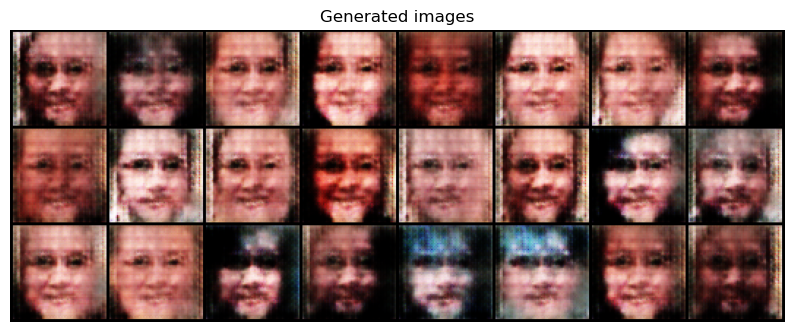

EPOCH: 55.000  g_loss: 2.136  d_loss: 0.725  (1087.56s - 98.87s remaining))
EPOCH: 60.000  g_loss: 2.118  d_loss: 0.717  (1247.64s - 0.00s remaining))


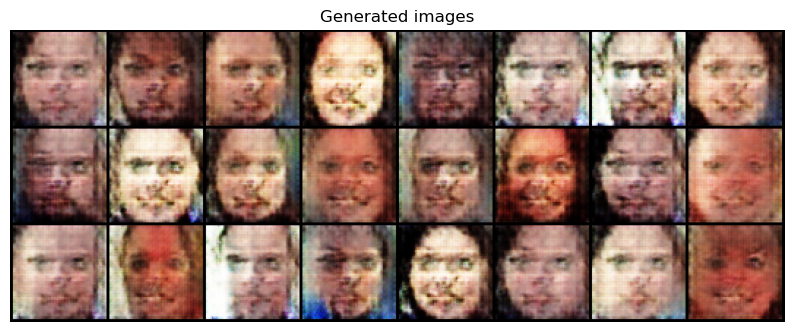

100%|██████████| 161/161 [00:00<00:00, 187.15it/s]


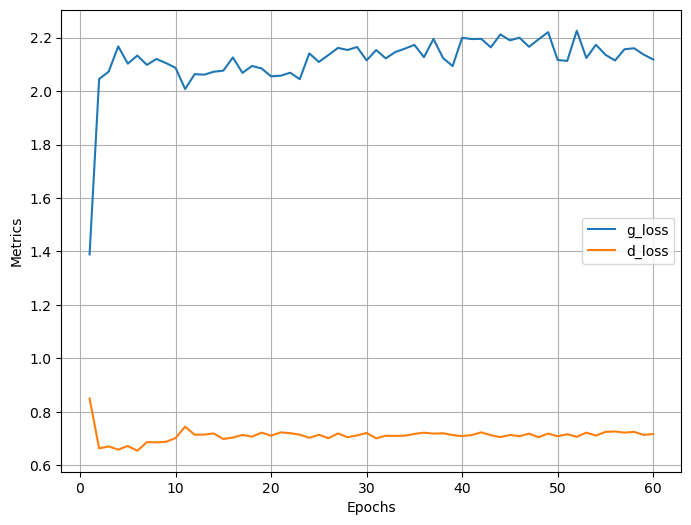

In [38]:
N = len(dataloader)
num_epochs = 60
log = Report(num_epochs)
repeat_generator=1
noise_dim = 100
batch_size = 128

for epoch in range(num_epochs):
    for idx, imgs in enumerate(dataloader):
        real_data = imgs.to(device)
        fake_data = generator(noise_generator(batch_size,noise_dim).to(device))
        fake_data = fake_data.detach()
        real_loss, fake_loss = train_discriminator(discriminator,fake_data,real_data,loss_fn,d_optimizer)
        real_loss, fake_loss = real_loss.item(), fake_loss.item()
        d_total = real_loss + fake_loss
        g_total = 0
        g_batch = 0
        #while g_avg >= 3:
        for i in range(repeat_generator):
            fake_data = generator(noise_generator(batch_size,noise_dim).to(device))
            g_loss = train_generator(discriminator,fake_data,loss_fn,g_optimizer)
            g_total += g_loss.item()

        log.record(epoch+(idx+1)/N,g_loss = g_total, d_loss = d_total, end='\r')
    if (epoch+1)%5 == 0:
        log.report_avgs(epoch+1)
    if (epoch+1)%10 == 0:
        torch.save(generator.state_dict(),model_name+r'/generator.pth')
        torch.save(discriminator.state_dict(),model_name+r"/discriminator.pth")
        generator.eval()
        noise = torch.randn(24, 100, device=device)
        sample_images = generator(noise).detach().cpu()
        grid = torchvision.utils.make_grid(sample_images, nrow=8, normalize=True)
        show(grid.cpu().detach().permute(1,2,0), sz=10, title='Generated images')
log.plot_epochs(['g_loss','d_loss'])

EPOCH: 5.000  g_loss: 0.736  fake_loss: 0.706  d_loss: 1.417  real_loss: 0.710  (783.79s - 18027.25s remaining)
EPOCH: 10.000  g_loss: 0.734  fake_loss: 0.700  d_loss: 1.415  real_loss: 0.715  (1566.98s - 17236.82s remaining)


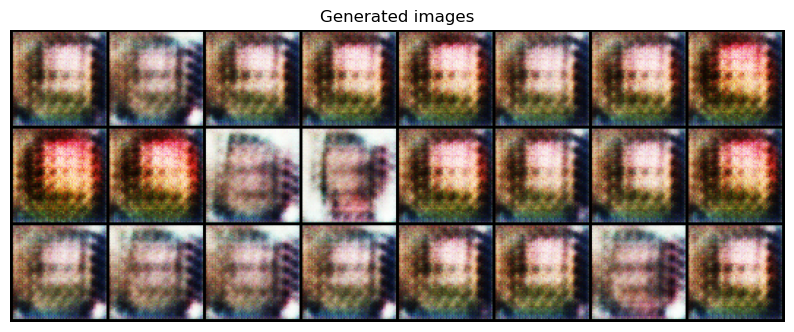

EPOCH: 15.000  g_loss: 0.727  fake_loss: 0.711  d_loss: 1.420  real_loss: 0.709  (2351.38s - 16459.67s remaining)
EPOCH: 20.000  g_loss: 0.730  fake_loss: 0.702  d_loss: 1.400  real_loss: 0.698  (3134.53s - 15672.67s remaining)


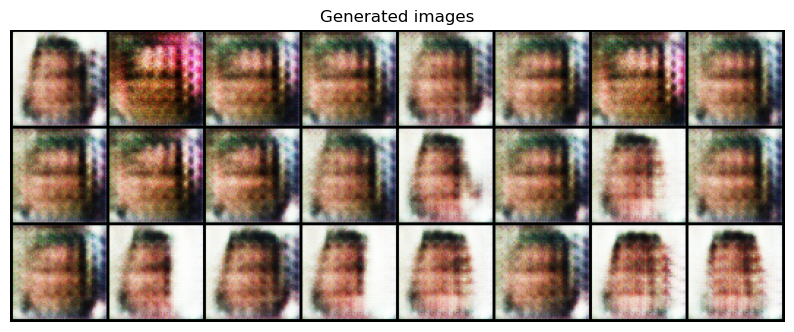

EPOCH: 25.000  g_loss: 0.734  fake_loss: 0.685  d_loss: 1.417  real_loss: 0.732  (3919.23s - 14893.08s remaining)
EPOCH: 30.000  g_loss: 0.819  fake_loss: 0.637  d_loss: 1.271  real_loss: 0.635  (4702.87s - 14108.61s remaining)


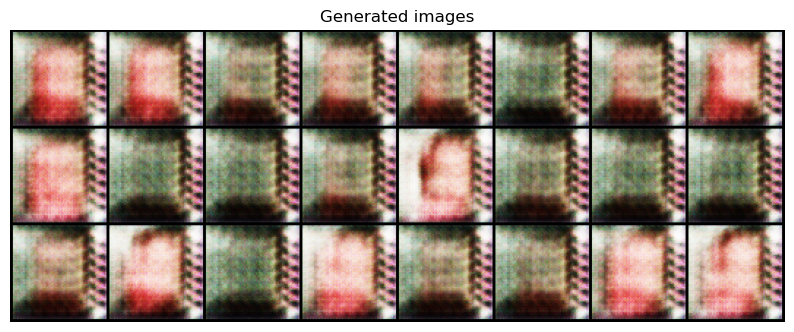

EPOCH: 35.000  g_loss: 0.720  fake_loss: 0.713  d_loss: 1.498  real_loss: 0.785  (5487.62s - 13327.07s remaining)
EPOCH: 40.000  g_loss: 0.685  fake_loss: 0.733  d_loss: 1.456  real_loss: 0.724  (6270.89s - 12541.78s remaining)


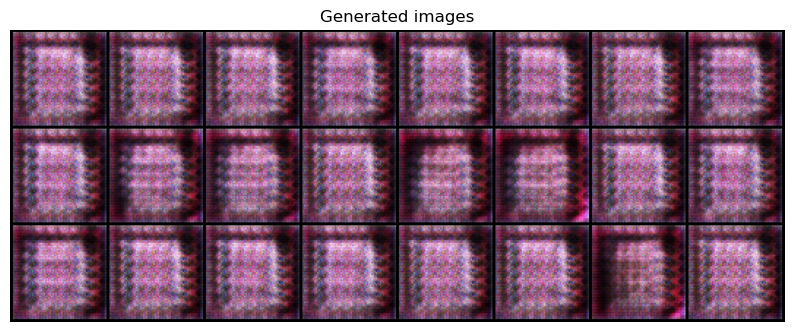

EPOCH: 45.000  g_loss: 0.710  fake_loss: 0.706  d_loss: 1.418  real_loss: 0.711  (7055.47s - 11759.12s remaining)
EPOCH: 50.000  g_loss: 0.706  fake_loss: 0.721  d_loss: 1.371  real_loss: 0.650  (7839.09s - 10974.73s remaining)


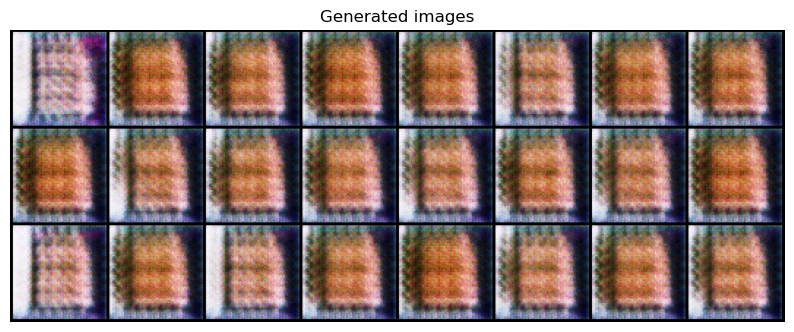

EPOCH: 55.000  g_loss: 0.716  fake_loss: 0.685  d_loss: 1.371  real_loss: 0.686  (8623.81s - 10191.78s remaining)
EPOCH: 60.000  g_loss: 0.756  fake_loss: 0.679  d_loss: 1.357  real_loss: 0.678  (9407.15s - 9407.15s remaining))


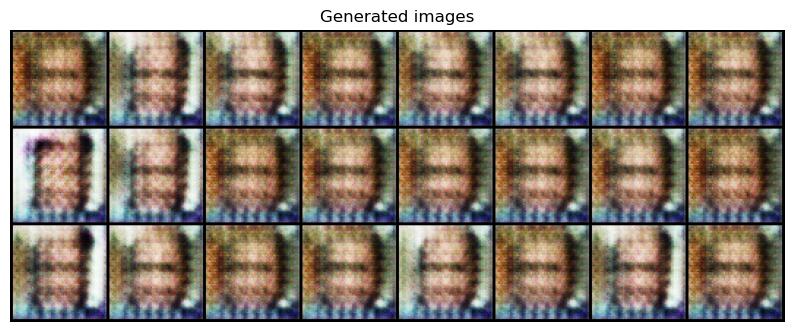

EPOCH: 65.000  g_loss: 0.722  fake_loss: 0.692  d_loss: 1.418  real_loss: 0.725  (10191.71s - 8623.75s remaining)
EPOCH: 70.000  g_loss: 0.719  fake_loss: 0.705  d_loss: 1.410  real_loss: 0.705  (10975.05s - 7839.32s remaining)


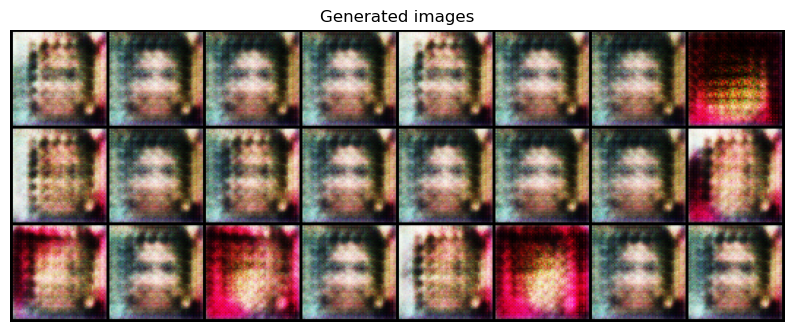

EPOCH: 75.000  g_loss: 0.784  fake_loss: 0.661  d_loss: 1.315  real_loss: 0.654  (11759.99s - 7055.99s remaining)
EPOCH: 80.000  g_loss: 0.726  fake_loss: 0.703  d_loss: 1.401  real_loss: 0.698  (12543.27s - 6271.64s remaining)


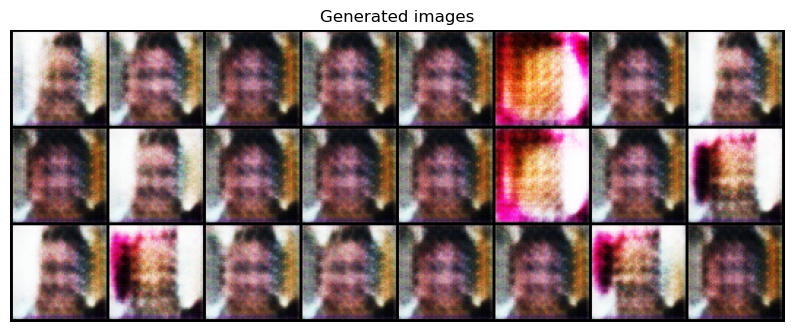

EPOCH: 85.000  g_loss: 0.724  fake_loss: 0.696  d_loss: 1.402  real_loss: 0.706  (13327.91s - 5487.96s remaining)
EPOCH: 90.000  g_loss: 0.732  fake_loss: 0.680  d_loss: 1.368  real_loss: 0.688  (14111.21s - 4703.74s remaining)


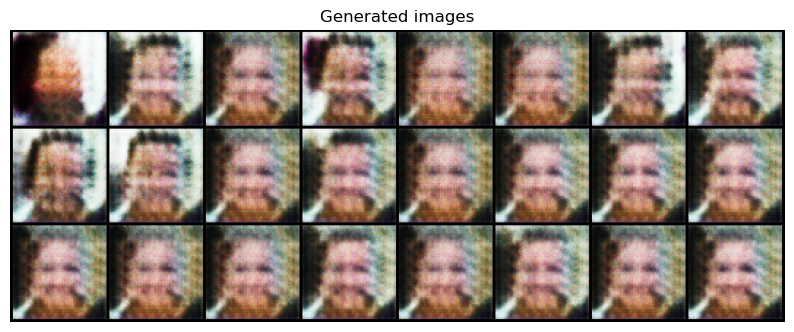

EPOCH: 95.000  g_loss: 0.700  fake_loss: 0.720  d_loss: 1.453  real_loss: 0.732  (14895.82s - 3919.95s remaining)
EPOCH: 100.000  g_loss: 0.720  fake_loss: 0.704  d_loss: 1.416  real_loss: 0.712  (15679.55s - 3135.91s remaining)


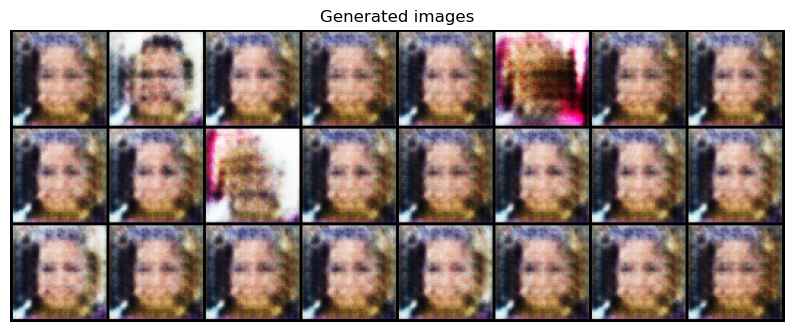

EPOCH: 105.000  g_loss: 0.733  fake_loss: 0.695  d_loss: 1.366  real_loss: 0.671  (16464.26s - 2352.04s remaining)
EPOCH: 110.000  g_loss: 0.728  fake_loss: 0.689  d_loss: 1.384  real_loss: 0.695  (17247.78s - 1567.98s remaining)


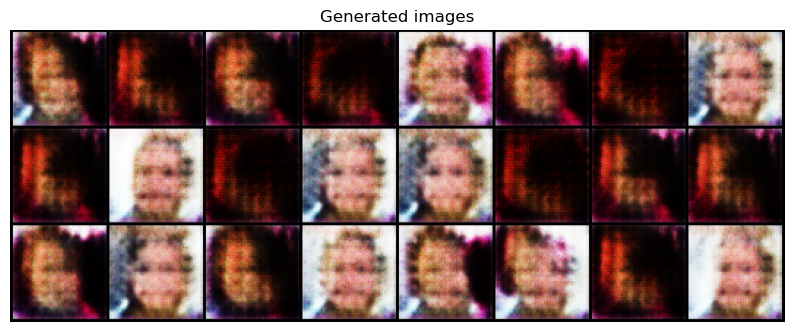

EPOCH: 115.000  g_loss: 0.685  fake_loss: 0.728  d_loss: 1.447  real_loss: 0.719  (18032.34s - 784.01s remaining))
EPOCH: 120.000  g_loss: 0.718  fake_loss: 0.696  d_loss: 1.412  real_loss: 0.716  (18816.03s - 0.00s remaining)))


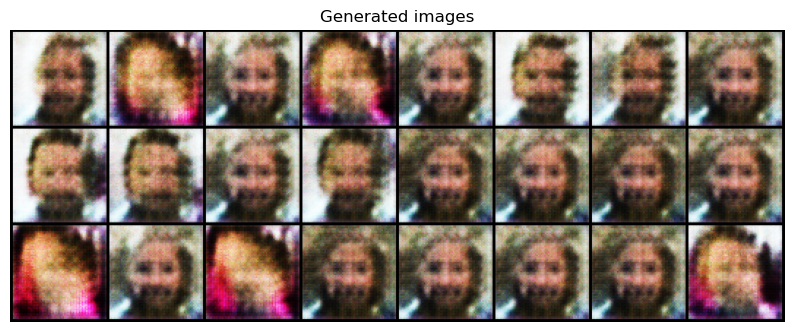

100%|██████████| 221/221 [00:00<00:00, 261.15it/s]


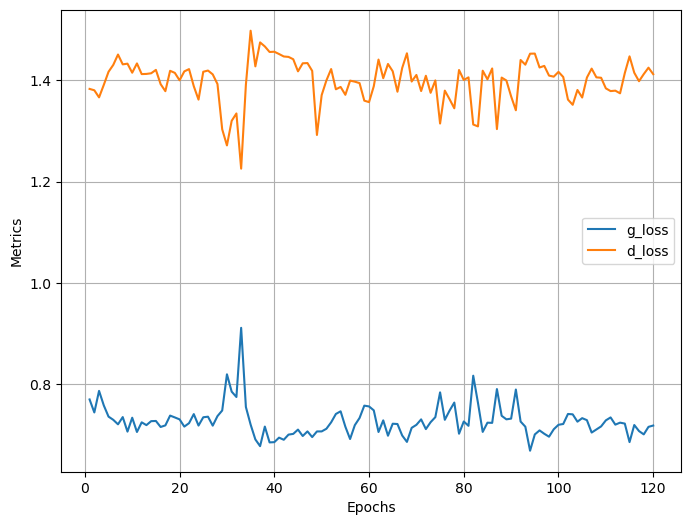

In [15]:
N = len(dataloader)
num_epochs = 120
log = Report(num_epochs)
repeat_generator=1
noise_dim = 512
batch_size = 128

for epoch in range(num_epochs):
    for idx, imgs in enumerate(dataloader):
        real_data = imgs.to(device)
        fake_data = generator(noise_generator(batch_size,noise_dim).to(device))
        fake_data = fake_data.detach()
        real_loss, fake_loss = train_discriminator(discriminator,fake_data,real_data,loss_fn,d_optimizer)
        real_loss, fake_loss = real_loss.item(), fake_loss.item()
        d_total = real_loss + fake_loss
        g_total = 0
        g_batch = 0
        #while g_avg >= 3:
        for i in range(repeat_generator):
            fake_data = generator(noise_generator(batch_size,noise_dim).to(device))
            g_loss = train_generator(discriminator,fake_data,loss_fn,g_optimizer)
            g_total += g_loss.item()

        log.record(epoch+(idx+1)/N,g_loss = g_total, d_loss = d_total, real_loss = real_loss, fake_loss = fake_loss, end='\r')
    if (epoch+1)%5 == 0:
        log.report_avgs(epoch+1)
    if (epoch+1)%10 == 0:
        torch.save(generator.state_dict(),model_name+r'/generator2.pth')
        torch.save(discriminator.state_dict(),model_name+r"/discriminator2.pth")
        generator.eval()
        noise = torch.randn(24, 512, device=device)
        sample_images = generator(noise).detach().cpu()
        grid = torchvision.utils.make_grid(sample_images, nrow=8, normalize=True)
        show(grid.cpu().detach().permute(1,2,0), sz=10, title='Generated images')
log.plot_epochs(['g_loss','d_loss'])
# torch.save(generator.state_dict(),model_name+r'/generator2.pth')
# torch.save(discriminator.state_dict(),model_name+r"/discriminator2.pth")

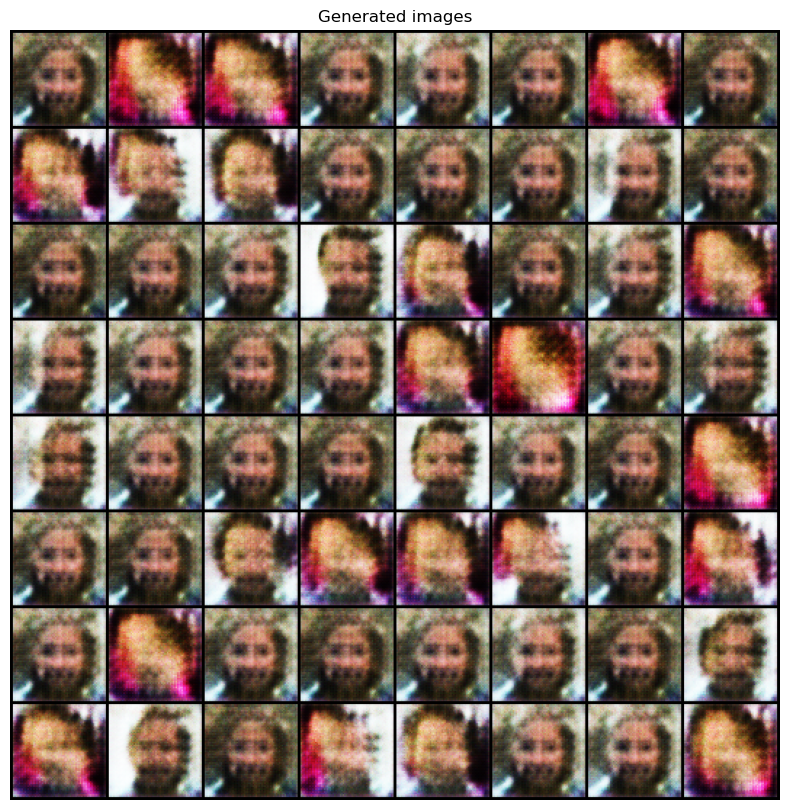

In [17]:
generator.eval()
noise = torch.randn(64, 512, device=device)
sample_images = generator(noise).detach().cpu()
grid = torchvision.utils.make_grid(sample_images, nrow=8, normalize=True)
show(grid.cpu().detach().permute(1,2,0), sz=10, title='Generated images')

EPOCH: 5.000  real_loss: 0.693  g_loss: 0.693  fake_loss: 0.695  d_loss: 1.389  (752.26s - 3761.32s remaining)
EPOCH: 10.000  real_loss: 0.696  g_loss: 0.695  fake_loss: 0.693  d_loss: 1.388  (1501.39s - 3002.78s remaining)


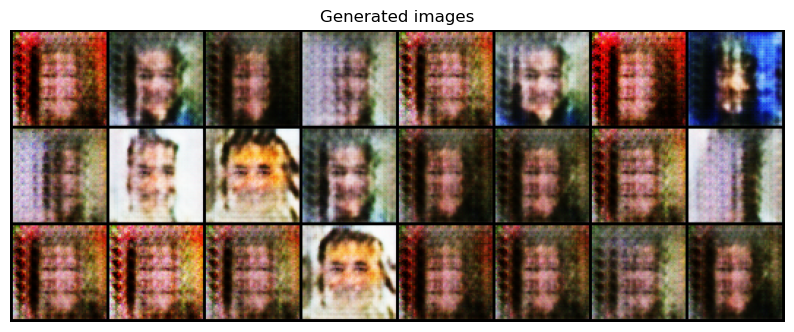

EPOCH: 15.000  real_loss: 0.692  g_loss: 0.693  fake_loss: 0.695  d_loss: 1.387  (2253.30s - 2253.30s remaining)
EPOCH: 20.000  real_loss: 0.677  g_loss: 0.704  fake_loss: 0.685  d_loss: 1.362  (3003.64s - 1501.82s remaining)


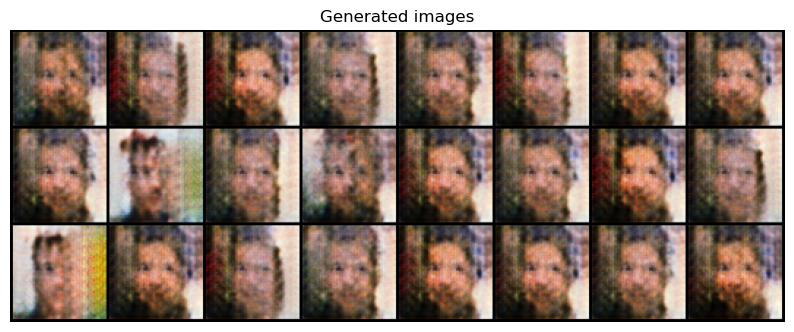

EPOCH: 21.808  g_loss: 0.702  d_loss: 1.393  real_loss: 0.677  fake_loss: 0.716  (3276.25s - 1230.69s remaining)

KeyboardInterrupt: 

In [21]:
N = len(dataloader)
num_epochs = 30
log = Report(num_epochs)
repeat_generator=1
noise_dim = 512
batch_size = 128

for epoch in range(num_epochs):
    for idx, imgs in enumerate(dataloader):
        real_data = imgs.to(device)
        fake_data = generator(noise_generator(batch_size,noise_dim).to(device))
        fake_data = fake_data.detach()
        real_loss, fake_loss = train_discriminator(discriminator,fake_data,real_data,loss_fn,d_optimizer)
        real_loss, fake_loss = real_loss.item(), fake_loss.item()
        d_total = real_loss + fake_loss
        g_total = 0
        g_batch = 0
        #while g_avg >= 3:
        for i in range(repeat_generator):
            fake_data = generator(noise_generator(batch_size,noise_dim).to(device))
            g_loss = train_generator(discriminator,fake_data,loss_fn,g_optimizer)
            g_total += g_loss.item()

        log.record(epoch+(idx+1)/N,g_loss = g_total, d_loss = d_total, real_loss = real_loss, fake_loss = fake_loss, end='\r')
    if (epoch+1)%5 == 0:
        log.report_avgs(epoch+1)
    if (epoch+1)%10 == 0:
        torch.save(generator.state_dict(),model_name+r'/generator3.pth')
        torch.save(discriminator.state_dict(),model_name+r"/discriminator3.pth")
        generator.eval()
        noise = torch.randn(24, 512, device=device)
        sample_images = generator(noise).detach().cpu()
        grid = torchvision.utils.make_grid(sample_images, nrow=8, normalize=True)
        show(grid.cpu().detach().permute(1,2,0), sz=10, title='Generated images')
log.plot_epochs(['g_loss','d_loss'])
# torch.save(generator.state_dict(),model_name+r'/generator2.pth')
# torch.save(discriminator.state_dict(),model_name+r"/discriminator2.pth")

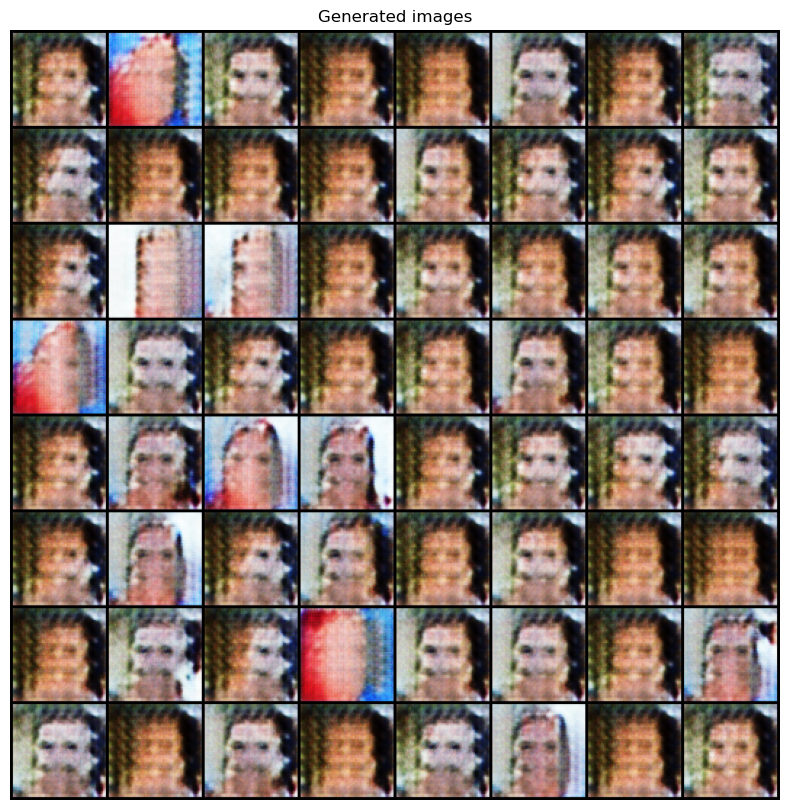

In [22]:
generator.eval()
noise = torch.randn(64, 512, device=device)
sample_images = generator(noise).detach().cpu()
grid = torchvision.utils.make_grid(sample_images, nrow=8, normalize=True)
show(grid.cpu().detach().permute(1,2,0), sz=10, title='Generated images')